# ML_Analysis

### Import Dependencies

In [20]:
import pandas as pd
import matplotlib.pyplot as plt

In [21]:
file=('Concat_ML_Data/first_debate.csv')
first_df=pd.read_csv(file)
first_df.head()

,tweet,replies_count,retweets_count,likes_count,candidate,tweet_length,Subjectivity,Polarity,Sentiment
0,Truly wish YOU had been the Moderator Brian Y...,0,0,0,Biden,40,0.1,-0.20,Negative
1,Crazy different RT Joe Biden hit Trump with th...,0,0,0,Biden,13,0.7,-0.20,Negative
2,Brilliant retort Joe The world hopes for your...,0,0,0,Biden,20,0.5,0.45,Positive
3,Anytime or slandering Joe Biden Me,0,2,2,Biden,6,0.0,0.00,Neutral
4,You are just trying to rile us and it working,0,0,1,Biden,10,0.0,0.00,Neutral


### Basic Metrics

In [23]:
# Separating entire dataset to sentiments for Trump and Biden
biden_sentiment=first_df[(first_df['candidate']=='Biden')]
trump_sentiment=first_df[(first_df['candidate']=='Trump')]

In [24]:
# Computing sentiment percentages for each candidate
biden_sentiments_by_type=biden_sentiment.groupby(['Sentiment']).count()['tweet']
total_biden_tweets=biden_sentiment.count()['tweet']
biden_sentiment_percents=100*biden_sentiments_by_type/total_biden_tweets

trump_sentiments_by_type=trump_sentiment.groupby(['Sentiment']).count()['tweet']
total_trump_tweets=trump_sentiment.count()['tweet']
trump_sentiment_percents=100*trump_sentiments_by_type/total_trump_tweets

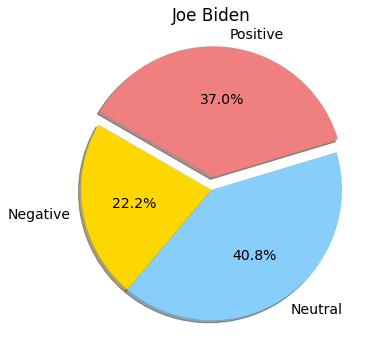

In [25]:
import matplotlib as mpl

plt.subplots(figsize=(10, 6))
plt.pie(biden_sentiment_percents,
    labels=["Negative", "Neutral", "Positive"],
    colors=["gold", "lightskyblue", "lightcoral"],
    explode=[0, 0, 0.1],
    autopct='%1.1f%%',
    shadow=True, startangle=150)
plt.title("Joe Biden")

mpl.rcParams['font.size'] = 14

# Show Figure
plt.show()

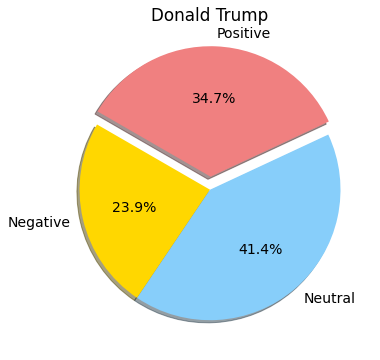

In [26]:
plt.subplots(figsize=(10, 6))
plt.pie(trump_sentiment_percents,
    labels=["Negative", "Neutral", "Positive"],
    colors=["gold", "lightskyblue", "lightcoral"],
    explode=[0, 0, 0.1],
    autopct='%1.1f%%',
    shadow=True, startangle=150)
plt.title("Donald Trump")

mpl.rcParams['font.size'] = 14

# Show Figure
plt.show()

### Word Cloud

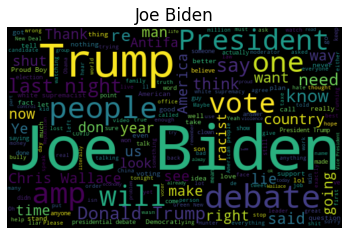

In [27]:
# Plotting a word cloud
# Import Dependencies
from wordcloud import WordCloud

allWordsBiden= ' '.join([twts for twts in biden_sentiment['tweet']])
wordCloud=WordCloud(width=500, height=300, random_state=21, max_font_size = 119).generate(allWordsBiden)
plt.imshow(wordCloud, interpolation='bilinear')
plt.axis('off')
plt.title('Joe Biden')
plt.show()

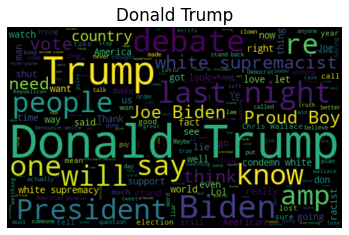

In [28]:
allWordsTrump= ' '.join([twts for twts in trump_sentiment['tweet']])
wordCloud=WordCloud(width=500, height=300, random_state=21, max_font_size = 119).generate(allWordsTrump)
plt.imshow(wordCloud, interpolation='bilinear')
plt.axis('off')
plt.title('Donald Trump')
plt.show()

In [29]:
# Import Dependencies
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import plotly.express as px
import hvplot.pandas

### Preprocessing Data 

In [20]:
# B = pd.get_dummies(biden_sentiment, columns=["Sentiment"]) # Dummify 'Sentiment' feature
# T = pd.get_dummies(trump_sentiment, columns=["Sentiment"])

In [30]:
biden_sentiment.drop(['tweet', 'candidate', 'Sentiment'], axis=1, inplace=True) # Dropping the 'tweet' column
trump_sentiment.drop(['tweet', 'candidate', 'Sentiment'], axis=1, inplace=True)

C:\Users\Greg\anaconda3\envs\PythonData\lib\site-packages\pandas\core\frame.py:3997: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [16]:
# X=X.rename(columns={"candidate_Trump": "candidate"}) # where 0=Biden and 1=Trump

### Plotting Elbow Curves

### Biden Elbow Curve

In [31]:
# Plotting Elbow Curve for Biden_Sentiments Data
inertia =[]
k = list(range(1, 11))

# Calculate the inertia for the range of K values
for i in k:
    km = KMeans(n_clusters=i, random_state=0)
    km.fit(biden_sentiment)
    inertia.append(km.inertia_)
    
# Plotting Elbow Curve with hvPlot
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", xticks=k, title="Elbow Curve")

:Curve   [k]   (inertia)

### Trump Elbow Curve

In [32]:
# Plotting Elbow Curve for Biden_Sentiments Data
inertia =[]
k = list(range(1, 11))

# Calculate the inertia for the range of K values
for i in k:
    km = KMeans(n_clusters=i, random_state=0)
    km.fit(trump_sentiment)
    inertia.append(km.inertia_)
    
# Plotting Elbow Curve with hvPlot
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", xticks=k, title="Elbow Curve")

:Curve   [k]   (inertia)

### Get Clusters Function

In [33]:
def get_clusters(k, data):
    
    # Creating a copy of 
    data = data.copy()
    
    # Initialize the K-Means model
    model = KMeans(n_clusters=k, random_state=0)
    
    # Fit the model
    model.fit(data)
    
    # Predict clusters
    predictions = model.predict(data)
    
    # Return DataFrame with predicted clusters
    data["class"] = model.labels_
    
    return data

### Biden Cluster Analysis

In [34]:
# From the elbow curve, testing for k = 3 or k = 4
biden_three_clusters = get_clusters(3, biden_sentiment)
biden_three_clusters.head()

,replies_count,retweets_count,likes_count,tweet_length,Subjectivity,Polarity,class
0,0,0,0,40,0.1,-0.20,0
1,0,0,0,13,0.7,-0.20,0
2,0,0,0,20,0.5,0.45,0
3,0,2,2,6,0.0,0.00,0
4,0,0,1,10,0.0,0.00,0


In [36]:
biden_four_clusters = get_clusters(4, biden_sentiment)
biden_four_clusters.head()

,replies_count,retweets_count,likes_count,tweet_length,Subjectivity,Polarity,class
0,0,0,0,40,0.1,-0.20,0
1,0,0,0,13,0.7,-0.20,0
2,0,0,0,20,0.5,0.45,0
3,0,2,2,6,0.0,0.00,0
4,0,0,1,10,0.0,0.00,0


### 2D Scatter Plot

In [37]:
# Plotting the 2D-Scatter with x="likes_count" and y="retweets_count" for K=4
biden_four_clusters.hvplot.scatter(x="likes_count", y="retweets_count", by="class")

:NdOverlay   [class]
   :Scatter   [likes_count]   (retweets_count)

In [38]:
# Plotting the 2D-Scatter with x="likes_count" and y="replies_count" for K=4
biden_four_clusters.hvplot.scatter(x="likes_count", y="replies_count", by="class")

:NdOverlay   [class]
   :Scatter   [likes_count]   (replies_count)

In [39]:
# Plotting the 2D-Scatter with x="likes_count" and y="Polarity" for K=4
biden_four_clusters.hvplot.scatter(x="likes_count", y="Polarity", by="class")

:NdOverlay   [class]
   :Scatter   [likes_count]   (Polarity)

### 3D Scatter Plot

In [41]:
# 3D scatter for K=4
fig = px.scatter_3d(
    biden_four_clusters,
    x="likes_count",
    y="retweets_count",
    z="replies_count",
    color="class",
    symbol="class",
    width=800,
)

fig.update_layout(legend=dict(x=0, y=1))
fig.show()

### Trump Cluster Analysis

In [43]:
# From the elbow curve, testing for  k = 3 and k = 4
trump_three_clusters = get_clusters(3, trump_sentiment)
trump_three_clusters.head()

,replies_count,retweets_count,likes_count,tweet_length,Subjectivity,Polarity,class
147166,0,0,0,29,0.40625,-0.156250,0
147167,0,0,0,2,0.00000,0.000000,0
147168,0,0,0,2,0.00000,0.000000,0
147169,0,0,0,39,0.32500,0.270833,0
147170,0,0,0,21,0.70000,0.500000,0


In [44]:
trump_four_clusters = get_clusters(4, trump_sentiment)
trump_four_clusters.head()

,replies_count,retweets_count,likes_count,tweet_length,Subjectivity,Polarity,class
147166,0,0,0,29,0.40625,-0.156250,0
147167,0,0,0,2,0.00000,0.000000,0
147168,0,0,0,2,0.00000,0.000000,0
147169,0,0,0,39,0.32500,0.270833,0
147170,0,0,0,21,0.70000,0.500000,0


### 2D Scatter Plot

In [50]:
# Plotting the 2D-Scatter with x="likes_count" and y="retweets_count" for K=4
trump_four_clusters.hvplot.scatter(x="likes_count", y="retweets_count", by="class")

:NdOverlay   [class]
   :Scatter   [likes_count]   (retweets_count)

In [51]:
# Plotting the 2D-Scatter with x="likes_count" and y="retweets_count" for K=4
trump_four_clusters.hvplot.scatter(x="likes_count", y="replies_count", by="class")

:NdOverlay   [class]
   :Scatter   [likes_count]   (replies_count)

In [52]:
# Plotting the 2D-Scatter with x="likes_count" and y="retweets_count" for K=4
trump_four_clusters.hvplot.scatter(x="likes_count", y="Polarity", by="class")

:NdOverlay   [class]
   :Scatter   [likes_count]   (Polarity)

### 3D Scatter Plot

In [53]:
# 3D scatter for K=4
fig = px.scatter_3d(
    trump_four_clusters,
    x="likes_count",
    y="retweets_count",
    z="replies_count",
    color="class",
    symbol="class",
    width=800,
)

fig.update_layout(legend=dict(x=0, y=1))
fig.show()

In [ ]:
# # Plotting clusters with two features
# # X.hvplot.scatter(x="Subjectivity", y="Polarity", by="candidate_Trump")
# cluster_1=pd.DataFrame(X, columns=['Polarity','candidate_Trump','likes_count'])

In [ ]:
# # Standardizing Data from X dataframe
# X_scaled = StandardScaler().fit_transform(cluster_1)
# print(X_scaled[0:4])

In [ ]:
# import plotly.express as px
# fig=px.scatter_3d(
#     four_clusters,
#     x="PC 1",
#     y="PC 2",
#     z="PC 3",
#     color="class",
#     symbol="class",
#     width=800,
# )

# fig.update_layout(legend=dict(x=0, y=1))
# fig.show()